# Libraries

In [1]:
import os
import time
import torch
import numpy as np
import pandas as pd
import torch.nn as nn
from pyflim import data
import pyift.pyift as ift
from pyflim import layers
from skimage import measure
from tqdm.notebook import tqdm
import matplotlib.pyplot as plt
# from torchvision import tv_tensors
import torchvision.transforms.v2 as T
from torch.utils.data import DataLoader
from scipy.spatial.distance import cdist
from skimage.filters import threshold_otsu
from PIL import Image, ImageOps, ImageDraw, ImageFilter
from skimage.morphology import binary_dilation, binary_erosion, disk
import math
import cv2

torch.manual_seed(123)
rng = np.random.default_rng(2021)

# Configuration

In [2]:
split = 3
# home = "/home/gilson/Documents/Disciplinas/PED_MO445/work2"
home = "/home/user/mo445/tarefa2"
orig_folder = f"{home}/datasets/schisto/images/"
label_folder= f"{home}/datasets/schisto/truelabels/"
marker_folder = f"{home}/data/schisto/split{split}/markers/"
train_split_file = f"{home}/data/schisto/split{split}/train{split}.csv"
test_split_file = f"{home}/data/schisto/split{split}/test{split}.csv"

lr=1e-3
wd=1e-4
device = 'cuda:0'
epochs = 100
lr_gamma = 0.97

# Data

Create the necessary datasets

In [3]:
images_list_flim_training = [i.replace("-seeds.txt", "") for i in os.listdir(marker_folder)] # list image filenames for flim training

images_list_gwe_training_ = list(pd.read_csv(train_split_file, header=None)[0]) # list image filenames for gwe (graph weight estimator) training
images_list_gwe_training_ = [i.replace('images/', '').replace('.png', '') for i in images_list_gwe_training_ 
                            if i not in images_list_flim_training and np.array(Image.open(label_folder+i.replace('images/', ''))).max() > 0] # remove blank labels and images in flim training

# this can be used to train the graph weight estimator with more images from trainN.csv
p = 0.5 # separating training and validation sets
len_ = len(images_list_gwe_training_)
images_list_gwe_training = images_list_gwe_training_[:int(p*len_)]
images_list_gwe_val = images_list_gwe_training_[int(p*len_):]

images_list_gwe_test_ = list(pd.read_csv(test_split_file, header=None)[0])
images_list_gwe_test = [i.replace('images/', '').replace('.png', '') for i in images_list_gwe_test_]

print('Nº Images for FLIM training:', len(images_list_flim_training))
print('Nº Images for GWE training:', len(images_list_gwe_training))
print('Nº Images for GWE validation:', len(images_list_gwe_val))
print('Nº Images for GWE test:', len(images_list_gwe_test))

train_dataset_flim_ = data.FLIMData(orig_folder=orig_folder, marker_folder=marker_folder, 
                                images_list=images_list_flim_training, label_folder=label_folder,
                                orig_ext=".png", marker_ext="-seeds.txt", label_ext=".png",
                                transform=data.transforms.Compose([data.ToTensor()]),lab_norm=False)

train_dataset_gwe_ = data.FLIMData(orig_folder=orig_folder, images_list=images_list_gwe_training, 
                                  label_folder=label_folder, orig_ext=".png",label_ext=".png",
                                transform=data.transforms.Compose([data.ToTensor()]),lab_norm=False)

val_dataset_gwe_ = data.FLIMData(orig_folder=orig_folder, images_list=images_list_gwe_val, 
                                  label_folder=label_folder, orig_ext=".png",label_ext=".png",
                                transform=data.transforms.Compose([data.ToTensor()]),lab_norm=False)

test_dataset_gwe_ = data.FLIMData(orig_folder=orig_folder, images_list=images_list_gwe_test, 
                                  label_folder=label_folder, orig_ext=".png",label_ext=".png",
                                transform=data.transforms.Compose([data.ToTensor()]),lab_norm=False)

train_dataset_gwe = DataLoader(train_dataset_gwe_, batch_size=1, shuffle=True) #train dataset for more than 3-4 images(not used yet)
train_dataset_flim = DataLoader(train_dataset_flim_, batch_size=1, shuffle=True) #train dataset with 3-4 images
val_dataset_gwe = DataLoader(val_dataset_gwe_, batch_size=1, shuffle=True) #train dataset with 3-4 images
test_dataset_gwe = DataLoader(test_dataset_gwe_, batch_size=1, shuffle=True) #test dataset

Nº Images for FLIM training: 4
Nº Images for GWE training: 163
Nº Images for GWE validation: 163
Nº Images for GWE test: 610


# Utils

In [4]:
#Filter components by area
def filter_component_by_area(saliency, area_range=[1800,10000]):
    bin_sal = np.copy(saliency)
    thresh = threshold_otsu(saliency)
    bin_sal[saliency>thresh] = 1
    bin_sal[saliency<=thresh] = 0
    saliency[bin_sal == 0] = 0
    sal_components_image = measure.label(bin_sal, background=0, connectivity=2)
    sal_nb_components = sal_components_image.max()
    
    bbs = []
    for c_ in range(1,sal_nb_components+1):
        area = len(sal_components_image[sal_components_image == c_])
        
        if (area < area_range[0] or area > area_range[1]):
            saliency[sal_components_image == c_] = 0
                
    return saliency
#select random pixels on binary images
def random_select(mask, percentage=0.3):
    mask = mask.astype(bool)
    
    indices = np.flatnonzero(mask)
    
    num_select = int(len(indices) * percentage)
    selected = rng.choice(indices, num_select, replace=False)
    
    new_mask = np.zeros_like(mask, dtype=np.uint8)
    new_mask.flat[selected] = 1
    return new_mask

def dice_score(true, pred):
        true = np.copy(true)
        pred = np.copy(pred)
        true[true > 0] = 1
        pred[pred > 0] = 1
        inter = true * pred
        denom = true + pred
        if(true.sum() == 0 and pred.sum() > 0):
            return 0.0
        elif(true.sum() > 0 and pred.sum() == 0):
            return 0.0
        elif(true.sum() == 0 and pred.sum() == 0):
            return 1.0
        return 2.0 * np.sum(inter) / np.sum(denom)

def f_beta_score(pred, gt, beta2=0.3, threshold=0.5):
    # Binarize prediction
    pred_bin = (pred >= threshold).astype(np.uint8)

    if(pred.max()==0 and gt.max()==0):
        return 1.0

    TP = np.sum((pred_bin == 1) & (gt == 1))
    FP = np.sum((pred_bin == 1) & (gt == 0))
    FN = np.sum((pred_bin == 0) & (gt == 1))

    if TP == 0:
        return 0.0
    
    precision = TP / (TP + FP + 1e-8)
    recall    = TP / (TP + FN + 1e-8)

    f_beta = ((1 + beta2) * precision * recall) / (beta2 * precision + recall + 1e-8)
    return float(f_beta)

def labnorm(image):
    new_image = torch.empty_like(image, dtype=image.dtype)

    new_image[:,0, :, :] = image[:,0, :, :] / 99.998337
    new_image[:,1, :, :] = (image[:,1, :, :] + 86.182236) / (86.182236 + 98.258614)
    new_image[:,2, :, :] = (image[:,2, :, :] + 107.867744) / (107.867744 + 94.481682)

    return new_image

def draw_borders(img, mask, edge_width=1, color='magenta'):
    if mask.max() == 1:
        mask = mask * 255
    mask = Image.fromarray(mask).convert("L")

    edges = mask.filter(ImageFilter.FIND_EDGES)

    if edge_width > 1:
        size = 2 * edge_width + 1
        edges = edges.filter(ImageFilter.MaxFilter(size=size))

    edges_rgb = ImageOps.colorize(edges.convert('L'), black='black', white=color)

    img = img.copy()
    img.paste(edges_rgb, mask=edges)

    return img

def dice_coefficient(pred_bin, gt):
    """Calculate Dice coefficient"""

    if pred_bin.max() == 0 and gt.max() == 0:
        return 1.0

    TP = np.sum((pred_bin == 1) & (gt == 1))
    FP = np.sum((pred_bin == 1) & (gt == 0))
    FN = np.sum((pred_bin == 0) & (gt == 1))

    if TP == 0:
        return 0.0

    dice = (2 * TP) / (2 * TP + FP + FN + 1e-8)
    return float(dice)

def sensitivity(pred_bin, gt):
    """Calculate Sensitivity (Recall)"""

    if pred_bin.max() == 0 and gt.max() == 0:
        return 1.0

    TP = np.sum((pred_bin == 1) & (gt == 1))
    FN = np.sum((pred_bin == 0) & (gt == 1))

    if TP + FN == 0:
        return 0.0

    sensitivity = TP / (TP + FN + 1e-8)
    return float(sensitivity)

def specificity(pred_bin, gt):
    """Calculate Specificity"""

    if pred_bin.max() == 0 and gt.max() == 0:
        return 1.0

    TN = np.sum((pred_bin == 0) & (gt == 0))
    FP = np.sum((pred_bin == 1) & (gt == 0))

    if TN + FP == 0:
        return 0.0

    specificity = TN / (TN + FP + 1e-8)
    return float(specificity)

def plot_image_columns_with_titles(col1, col2, col3, titles, save_path):
    if not (len(col1) == len(col2) == len(col3) == len(titles)):
        raise ValueError("All input lists must have the same length")
    
    num_rows = len(col1)
    
    # Create figure with appropriate size
    fig, axes = plt.subplots(num_rows, 4, figsize=(12, 3 * num_rows))
    
    # If only one row, axes is 1D → make it 2D
    if num_rows == 1:
        axes = [axes]

    for i in range(num_rows):
        # Column 0: title
        ax_title = axes[i][0]
        ax_title.text(0.5, 0.5, titles[i], ha='center', va='center', fontsize=32)
        ax_title.axis('off')
        
        # Column 1
        axes[i][1].imshow(col1[i])
        axes[i][1].axis('off')

        # Column 2
        axes[i][2].imshow(col2[i])
        axes[i][2].axis('off')

        # Column 3
        axes[i][3].imshow(col3[i])
        axes[i][3].axis('off')
    
    plt.tight_layout()
    plt.savefig(save_path, bbox_inches='tight', transparent=True)
    plt.close(fig)


def plot_images(images, titles=None, cols=None, save_fig=None, max_width=20, max_height=15):

    n = len(images)
    
    # Automatically choose number of columns
    if cols is None:
        cols = math.ceil(math.sqrt(n))
    
    rows = math.ceil(n / cols)

    # Flexible figure size
    fig_width = min(cols * 3, max_width)   # 3 inches per image, capped
    fig_height = min(rows * 3, max_height) # 3 inches per image, capped

    fig, axes = plt.subplots(rows, cols, figsize=(fig_width, fig_height))
    axes = axes.flatten()  # make it a 1D list for easy indexing
    
    # checks if there are pre-defined titles
    if titles == None:
        titles = [str(i) for i in range(1,n+1)]
        title_flag = False
    else:
        title_flag = True

    for ax, img, title in zip(axes, images, titles):
        try:
            ax.imshow(img)
            if title_flag:
                try:
                    ax.set_title(title)
                except Exception as e:
                    continue
            ax.axis("off")
        except Exception as e:
            ax.text(0.5, 0.5, f"Error:\n{e}", ha='center', va='center')
            ax.axis("off")

    # Hide unused subplots if number of images < rows*cols
    for ax in axes[n:]:
        ax.axis("off")
    
    plt.tight_layout()


    if save_fig!=None:
        os.makedirs(os.path.dirname(save_fig), exist_ok=True)
        plt.savefig(save_fig, transparent=True)

    plt.show()
    
    return


# Graph estimator network

In [5]:
class GraphWeightEstimator(nn.Module):
    def __init__(self, original_size=(400, 400), embed_dim=8, kernel_size=11, dilation=1):
        super().__init__()
        self.original_size = original_size
        self.kernel_size = kernel_size
        self.dilation = dilation
        self.embed_dim = embed_dim
        
        # Effective kernel size accounting for dilation
        effective_kernel = dilation * (kernel_size - 1) + 1
        
        # Adjust padding to keep the same spatial size
        self.padding = (effective_kernel - 1) // 2

        self.unfold = nn.Unfold(
            kernel_size=self.kernel_size,
            padding=self.padding,
            stride=1,
            dilation=self.dilation
        )
        
        self.fold = nn.Fold(
            output_size=self.original_size,
            kernel_size=1,
            padding=0,
            stride=1
        )

        self.fc = nn.Sequential(
            nn.Linear(3 * kernel_size * kernel_size, 128),
            nn.LeakyReLU(),
            nn.Linear(128, 64),
            nn.LeakyReLU(),
            nn.Linear(64, self.embed_dim)
        )
        
    def forward(self, x):
        # x: (B, 3, H, W)
        x = self.unfold(x)                  # (B, C*k*k, H*W)
        y = self.fc(x.permute(0, 2, 1))     # (B, H*W, embed_dim)
        y = y.permute(0, 2, 1)              # (B, embed_dim, H*W)
        y = self.fold(y)                    # (B, embed_dim, H, W)
        y = y.squeeze(0).permute(1, 2, 0)   # (H, W, embed_dim)
        y = torch.nn.functional.normalize(y, p=2, dim=-1)
        return y

graph_weight_estimator = GraphWeightEstimator(original_size=(400,400), kernel_size=7, embed_dim=8, dilation=1).to(device)
optimizer = torch.optim.Adam(graph_weight_estimator.parameters(), lr=lr, weight_decay=wd)
# scheduler = torch.optim.lr_scheduler.CyclicLR(optimizer, base_lr=lr, max_lr=1e-2,step_size_up=20,mode="exp_range",gamma=lr_gamma)
scheduler = torch.optim.lr_scheduler.CyclicLR(optimizer, base_lr=lr, max_lr=1e-2,step_size_up=20,mode="exp_range",gamma=lr_gamma,cycle_momentum=False) # had to disable cycle_momentum (Adam is not compatible)
loss_fn = nn.TripletMarginLoss(margin=0.2)

flim_model = torch.load(f'{home}/models/flim/split{split}/flim_encoder_split{split}.pth', weights_only=False)
# Here you can set any adaptive decoder:
# mean_based_ad
# probability_based_ad
# vanilla_adaptive_decoder
# labeled_marker_d
flim_model.decoder = layers.FLIMAdaptiveDecoderLayer(1,filter_by_size=False, device=device,adj_radius=1.5, decoder_type='mean_based_ad')

# Train

Check if GPU is being used

In [6]:
import torch
print(torch.cuda.is_available())
print(torch.cuda.device_count())
print(torch.cuda.get_device_name(0))

True
1
NVIDIA GeForce RTX 4060 Laptop GPU


In [7]:
start_time = time.perf_counter()
graph_weight_estimator.train()
best_loss = np.inf
accum_steps=len(train_dataset_flim)
for epoch in range(epochs):
    train_loss = 0
    val_loss = 0
    for i,sample in enumerate(train_dataset_flim):
        x,y,p=sample['image'].cuda(),sample['label'], sample['image_path']
        y[y>0] = 1
        if(y.max() == 0):
            continue
        
        y = y[0].cpu().numpy()

        # representation for each pixel of the image
        representation = graph_weight_estimator(x)
        
        # random subset of data-points
        eroded = binary_erosion(y, footprint=disk(1))
        dilated = binary_dilation(y, footprint=disk(2))
        
        
        training_1 = random_select(eroded, percentage=0.5)
        training_0 = random_select(1-dilated, percentage=0.1)


        # eroded = binary_erosion(y, footprint=disk(10))
        # dilated = binary_dilation(y, footprint=disk(40))
        
        
        # training_1 = random_select(eroded, percentage=0.005)
        # training_0 = random_select(1-dilated, percentage=0.005)

        seeds_in = training_1.astype(np.int32)
        seeds_out = training_0.astype(np.int32)

        seeds_in_mimg = ift.CreateImageFromNumPy(seeds_in, is3D=False)
        seeds_out_mimg = ift.CreateImageFromNumPy(seeds_out, is3D=False)

        res_mimg = ift.CreateMImageFromNumPy(np.ascontiguousarray(representation.detach().cpu().numpy().astype(np.float32)))

        #(i) propagation of the labels with DT
        # res = ift.DynamicTrees(res_mimg, seeds_in_mimg, seeds_out_mimg, 1)  
        res = ift.DynamicTrees(res_mimg, seeds_in_mimg, seeds_out_mimg)        

        res = res.AsNumPy()
        
        #(ii) subsets of correct labeled points of each class (0,1)
        x_correct_1 = np.argwhere((res == 1) & (y == 1))
        x_correct_0 = np.argwhere((res == 0) & (y == 0))

        #balance sizes
        rng.shuffle(x_correct_0)
        x_correct_0 = x_correct_0[:x_correct_1.shape[0], :]

        #shuffle indices
        rng.shuffle(x_correct_1)
        
        #split into two parts
        half = x_correct_1.shape[0] // 2
        anchors_idx  = x_correct_1[:half]
        positives_idx = x_correct_1[half:2*half]

        #extract representations
        anchor_1   = representation[anchors_idx[:,0], anchors_idx[:,1]]
        positive_1 = representation[positives_idx[:,0], positives_idx[:,1]]
        negative_1 = representation[x_correct_0[:half,0], x_correct_0[:half,1]]
        
        loss = loss_fn(anchor_1, positive_1, negative_1)
        
        l2_regularization = 0
        for param in graph_weight_estimator.fc.parameters():
            l2_regularization += torch.norm(param, 2)

        loss += 0.00001 * l2_regularization

        # accumulating the loss for each image to simulate batch
        loss.backward()
        train_loss += loss.item()

        # only optimizes in the last image
        if(i+1)%accum_steps == 0:
            optimizer.step()
            scheduler.step()
            optimizer.zero_grad()        

    train_loss = train_loss / len(train_dataset_flim)    
    
    if(train_loss == 0):
        train_loss.append(0)
    if(train_loss < best_loss):
        best_loss = train_loss
        torch.save(graph_weight_estimator, f'{home}/models/estimator_network/best_model_w_flim_triplet_split{split}.pth') # disks 1 e 2; percentages: 0.5, 0.1
        # torch.save(graph_weight_estimator, f'{home}/models/estimator_network/best_model_disks10_40_percentage0_5{split}.pth') # disks 10 e 40; percentages: 0.005
    print('Epoch: ', epoch, 'Loss: ', train_loss,  end="\r")
print('time:', time.perf_counter()-start_time)

time: 98.9429175130.0068413068074733025


# Validation

Test the trained GWE model in the validation dataset.

In [8]:
del graph_weight_estimator

graph_weight_estimator = torch.load(f'{home}/models/estimator_network/best_model_w_flim_triplet_split{split}.pth', weights_only=False)


test_loss_lab = []
test_loss_mlp = []
graph_weight_estimator.eval()
flim_model.eval()
start_time = time.perf_counter()
use_gt = False


fbeta_mlp_scores = []
fbeta_lab_scores = []

sensitivity_mlp_scores = []
sensitivity_lab_scores = []

specificity_mlp_scores = []
specificity_lab_scores = []

dice_mlp_scores = []
dice_lab_scores = []
worst_imgs = []
worst_titles = []
worst_saliencies = []
worst_gts = []

with torch.no_grad():    
    for sample in tqdm(val_dataset_gwe):
        x,y=sample['image'].cuda(),sample['label']
        y[y>0] = 1
        y = y[0].cpu().numpy()
        
        representation = graph_weight_estimator(x)

        if(not use_gt):   
            x_t = labnorm(x)
            y_t = flim_model.forward(x_t, decoder_layer=0)
            y_t = y_t.squeeze().detach().cpu().numpy()
            saliency = ift.CreateImageFromNumPy((y_t).astype(np.int32), is3D=False)
        else:
            saliency = ift.CreateImageFromNumPy((y*255).astype(np.int32), is3D=False)

        res_mimg = ift.CreateMImageFromNumPy(np.ascontiguousarray(representation.detach().cpu().numpy().astype(np.float32)))
        orig_mimg = ift.CreateMImageFromNumPy(np.ascontiguousarray(x.squeeze().permute((1,2,0)).detach().cpu().numpy().astype(np.float32)))

        # Here we use a method that do pre-processings on the masks before dynamic trees, for details look at iftSegmentation.c
        # Parameters: (mimg, saliency, border, min comp area, max comp area, saliency erosion, saliency dilation)
        if(not use_gt):
            res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 2, 30)       
            res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 2, 30)
            # res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 10, 40)       
            # res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 10, 40)
        else:
            res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 5, 10)       
            res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 5, 10)
            # res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 10, 40)       
            # res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 10, 40)
        
        res = res.AsNumPy()
        res1 = res1.AsNumPy()
        
        # loss_mlp = f_beta_score(y, res)
        # loss_lab = f_beta_score(y, res1)
        
        # test_loss_mlp.append(loss_mlp) 
        # test_loss_lab.append(loss_lab)

        f_beta_mlp = f_beta_score(y, res)
        f_beta_lab = f_beta_score(y, res1)
        fbeta_mlp_scores.append(f_beta_mlp)
        fbeta_lab_scores.append(f_beta_lab)
        
        y = (y > 0.5).astype(np.uint8)
        sens_mlp = sensitivity(res, y)
        sens_lab = sensitivity(res1, y)
        sensitivity_mlp_scores.append(sens_mlp)
        sensitivity_lab_scores.append(sens_lab)
        
        specificity_mlp = specificity(res, y)
        specificity_lab = specificity(res1, y)
        specificity_mlp_scores.append(specificity_mlp)
        specificity_lab_scores.append(specificity_lab)
        
        dice_mlp = dice_score(res, y)
        dice_lab = dice_score(res1, y)
        dice_mlp_scores.append(dice_mlp)
        dice_lab_scores.append(dice_lab)

        if f_beta_mlp<0.2:
            worst_titles.append(os.path.basename(sample['image_path'][0]))
            worst_imgs.append(np.array(Image.open(sample['image_path'][0])))
            worst_gts.append(y)
            if not use_gt:
                worst_saliencies.append(y_t)

print('time:', time.perf_counter()-start_time)

# print('Metric lab: ', np.mean(test_loss_lab),'+-',np.std(test_loss_lab), '| Metric lab Std: ', np.std(test_loss_lab), end="\n")
# print('Metric mlp: ', np.mean(test_loss_mlp),'+-',np.std(test_loss_mlp), '| Metric mlp Std: ', np.std(test_loss_mlp), end="\n")

print(f"F-beta MLP: {np.mean(fbeta_mlp_scores):.4f} ± {np.std(fbeta_mlp_scores):.4f} | "
      f"F-beta Lab: {np.mean(fbeta_lab_scores):.4f} ± {np.std(fbeta_lab_scores):.4f}")

print(f"Sensitivity MLP: {np.mean(sensitivity_mlp_scores):.4f} ± {np.std(sensitivity_mlp_scores):.4f} | "
      f"Sensitivity Lab: {np.mean(sensitivity_lab_scores):.4f} ± {np.std(sensitivity_lab_scores):.4f}")

print(f"Specificity MLP: {np.mean(specificity_mlp_scores):.4f} ± {np.std(specificity_mlp_scores):.4f} | "
      f"Specificity Lab: {np.mean(specificity_lab_scores):.4f} ± {np.std(specificity_lab_scores):.4f}")

print(f"Dice MLP: {np.mean(dice_mlp_scores):.4f} ± {np.std(dice_mlp_scores):.4f} | "
      f"Dice Lab: {np.mean(dice_lab_scores):.4f} ± {np.std(dice_lab_scores):.4f}")

  0%|          | 0/163 [00:00<?, ?it/s]

time: 34.06185466499994
F-beta MLP: 0.8348 ± 0.2413 | F-beta Lab: 0.8136 ± 0.2166
Sensitivity MLP: 0.9039 ± 0.2508 | Sensitivity Lab: 0.8239 ± 0.2144
Specificity MLP: 0.9891 ± 0.0142 | Specificity Lab: 0.9945 ± 0.0123
Dice MLP: 0.7775 ± 0.2426 | Dice Lab: 0.8142 ± 0.2334


Let's plot all the worst images (F-beta<20%)

In [9]:
# saves all the worst cases in a singl figure
plot_image_columns_with_titles(worst_imgs, worst_saliencies, worst_gts, titles=worst_titles, save_path=f"{home}/report/worst_imgs_triplets.png")

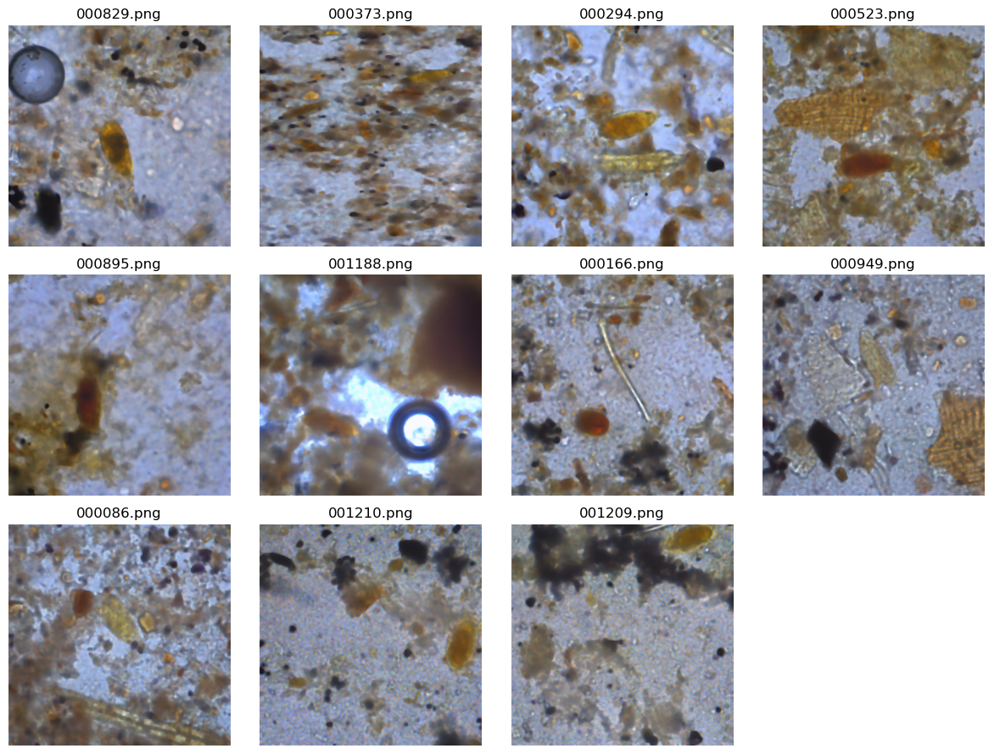

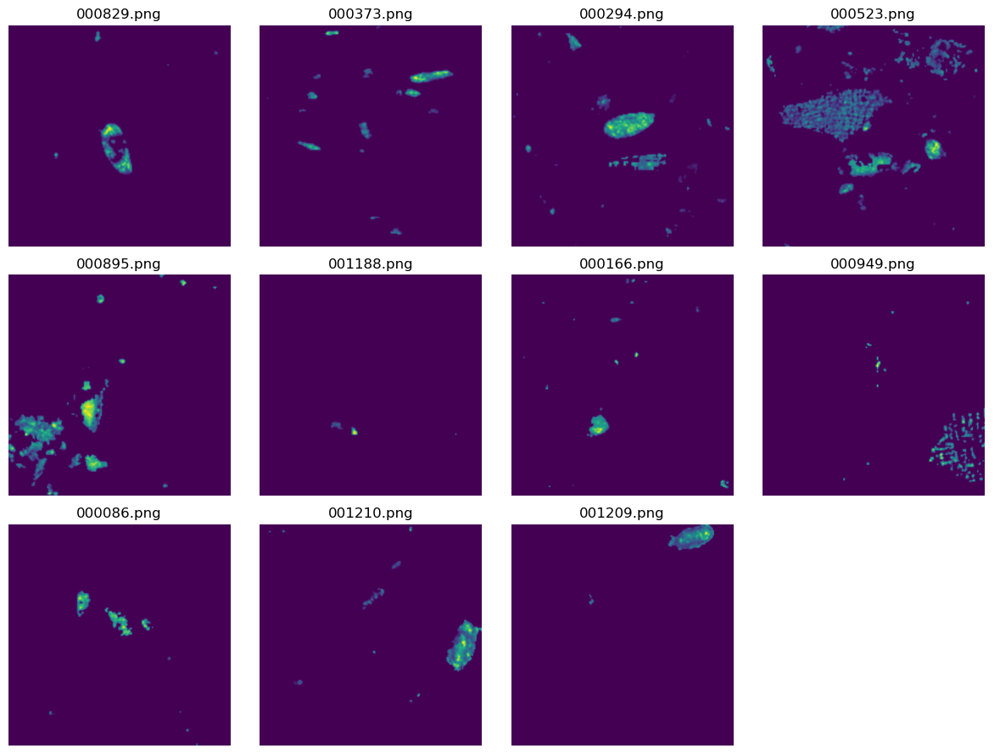

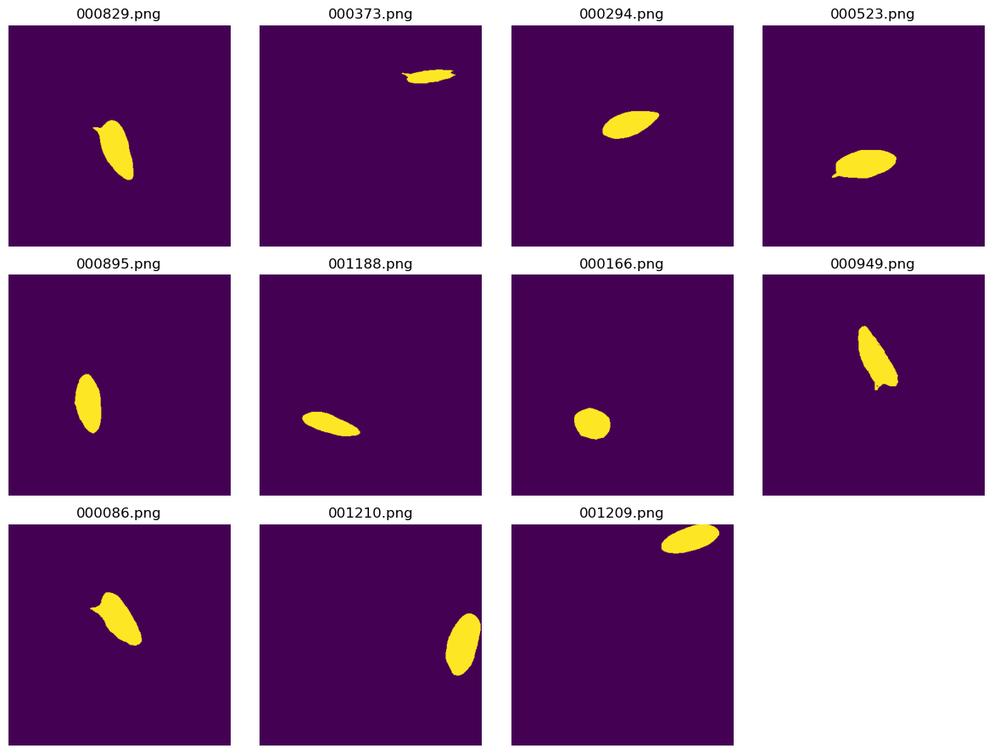

In [10]:
plot_images(worst_imgs, titles=worst_titles, save_fig=f"{home}/report/worst_imgs.png")
plot_images(worst_saliencies, titles=worst_titles, save_fig=f"{home}/report/worst_saliencies.png")
plot_images(worst_gts, titles=worst_titles, save_fig=f"{home}/report/worst_gts.png")
worst_titles_val = worst_titles

# Test

Now, let's test the pipeline in the test dataset

In [11]:
del graph_weight_estimator

graph_weight_estimator = torch.load(f'{home}/models/estimator_network/best_model_w_flim_triplet_split{split}.pth', weights_only=False)
# graph_weight_estimator = torch.load(f'{home}/models/estimator_network/best_model_disks10_40_percentage0_5{split}.pth', weights_only=False)

In [12]:

test_loss_lab = []
test_loss_mlp = []
graph_weight_estimator.eval()
flim_model.eval()
start_time = time.perf_counter()
use_gt = False


fbeta_mlp_scores = []
fbeta_lab_scores = []

sensitivity_mlp_scores = []
sensitivity_lab_scores = []

specificity_mlp_scores = []
specificity_lab_scores = []

dice_mlp_scores = []
dice_lab_scores = []

with torch.no_grad():    
    for sample in tqdm(test_dataset_gwe):
        x,y=sample['image'].cuda(),sample['label']
        y[y>0] = 1
        y = y[0].cpu().numpy()
        
        representation = graph_weight_estimator(x)

        if(not use_gt):   
            x_t = labnorm(x)
            y_t = flim_model.forward(x_t, decoder_layer=0)
            y_t = y_t.squeeze().detach().cpu().numpy()
            saliency = ift.CreateImageFromNumPy((y_t).astype(np.int32), is3D=False)
        else:
            saliency = ift.CreateImageFromNumPy((y*255).astype(np.int32), is3D=False)

        res_mimg = ift.CreateMImageFromNumPy(np.ascontiguousarray(representation.detach().cpu().numpy().astype(np.float32)))
        orig_mimg = ift.CreateMImageFromNumPy(np.ascontiguousarray(x.squeeze().permute((1,2,0)).detach().cpu().numpy().astype(np.float32)))

        # Here we use a method that do pre-processings on the masks before dynamic trees, for details look at iftSegmentation.c
        # Parameters: (mimg, saliency, border, min comp area, max comp area, saliency erosion, saliency dilation)
        if(not use_gt):
            res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 2, 30)       
            res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 2, 30)
            # res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 10, 40)       
            # res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 10, 40)
        else:
            res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 5, 10)       
            res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 5, 10)
            # res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 10, 40)       
            # res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 10, 40)
        
        res = res.AsNumPy()
        res1 = res1.AsNumPy()
        
        # loss_mlp = f_beta_score(y, res)
        # loss_lab = f_beta_score(y, res1)
        
        # test_loss_mlp.append(loss_mlp) 
        # test_loss_lab.append(loss_lab)

        f_beta_mlp = f_beta_score(y, res)
        f_beta_lab = f_beta_score(y, res1)
        fbeta_mlp_scores.append(f_beta_mlp)
        fbeta_lab_scores.append(f_beta_lab)
        
        y = (y > 0.5).astype(np.uint8)
        sens_mlp = sensitivity(res, y)
        sens_lab = sensitivity(res1, y)
        sensitivity_mlp_scores.append(sens_mlp)
        sensitivity_lab_scores.append(sens_lab)
        
        specificity_mlp = specificity(res, y)
        specificity_lab = specificity(res1, y)
        specificity_mlp_scores.append(specificity_mlp)
        specificity_lab_scores.append(specificity_lab)
        
        dice_mlp = dice_score(res, y)
        dice_lab = dice_score(res1, y)
        dice_mlp_scores.append(dice_mlp)
        dice_lab_scores.append(dice_lab)

print('time:', time.perf_counter()-start_time)

# print('Metric lab: ', np.mean(test_loss_lab),'+-',np.std(test_loss_lab), '| Metric lab Std: ', np.std(test_loss_lab), end="\n")
# print('Metric mlp: ', np.mean(test_loss_mlp),'+-',np.std(test_loss_mlp), '| Metric mlp Std: ', np.std(test_loss_mlp), end="\n")

print(f"F-beta MLP: {np.mean(fbeta_mlp_scores):.4f} ± {np.std(fbeta_mlp_scores):.4f} | "
      f"F-beta Lab: {np.mean(fbeta_lab_scores):.4f} ± {np.std(fbeta_lab_scores):.4f}")

print(f"Sensitivity MLP: {np.mean(sensitivity_mlp_scores):.4f} ± {np.std(sensitivity_mlp_scores):.4f} | "
      f"Sensitivity Lab: {np.mean(sensitivity_lab_scores):.4f} ± {np.std(sensitivity_lab_scores):.4f}")

print(f"Specificity MLP: {np.mean(specificity_mlp_scores):.4f} ± {np.std(specificity_mlp_scores):.4f} | "
      f"Specificity Lab: {np.mean(specificity_lab_scores):.4f} ± {np.std(specificity_lab_scores):.4f}")

print(f"Dice MLP: {np.mean(dice_mlp_scores):.4f} ± {np.std(dice_mlp_scores):.4f} | "
      f"Dice Lab: {np.mean(dice_lab_scores):.4f} ± {np.std(dice_lab_scores):.4f}")

  0%|          | 0/610 [00:00<?, ?it/s]

time: 101.05942133400004
F-beta MLP: 0.8547 ± 0.2944 | F-beta Lab: 0.8446 ± 0.2886
Sensitivity MLP: 0.8861 ± 0.3000 | Sensitivity Lab: 0.8459 ± 0.2886
Specificity MLP: 0.9932 ± 0.0109 | Specificity Lab: 0.9961 ± 0.0097
Dice MLP: 0.8262 ± 0.2947 | Dice Lab: 0.8466 ± 0.2919


Now, let's see the outputs of different parts of the pipeline:

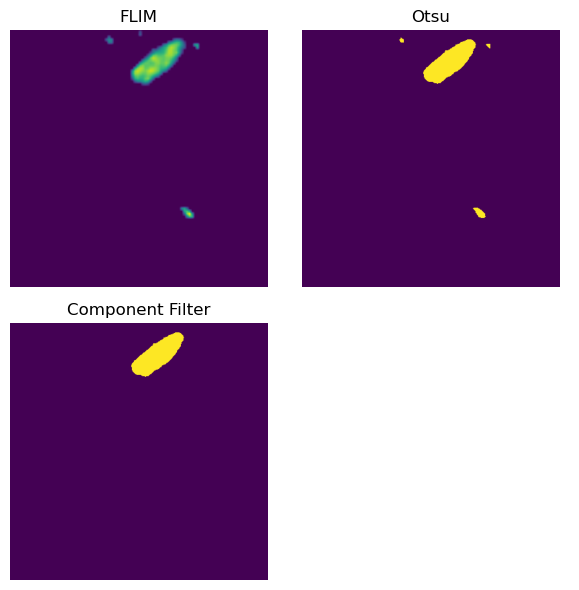

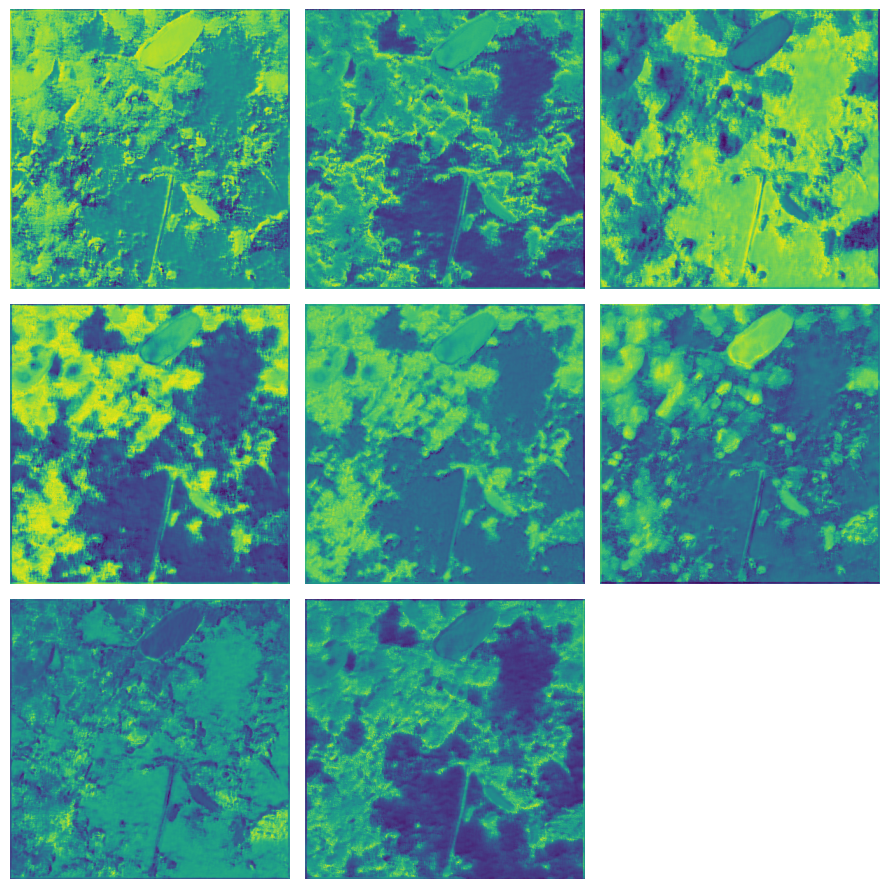

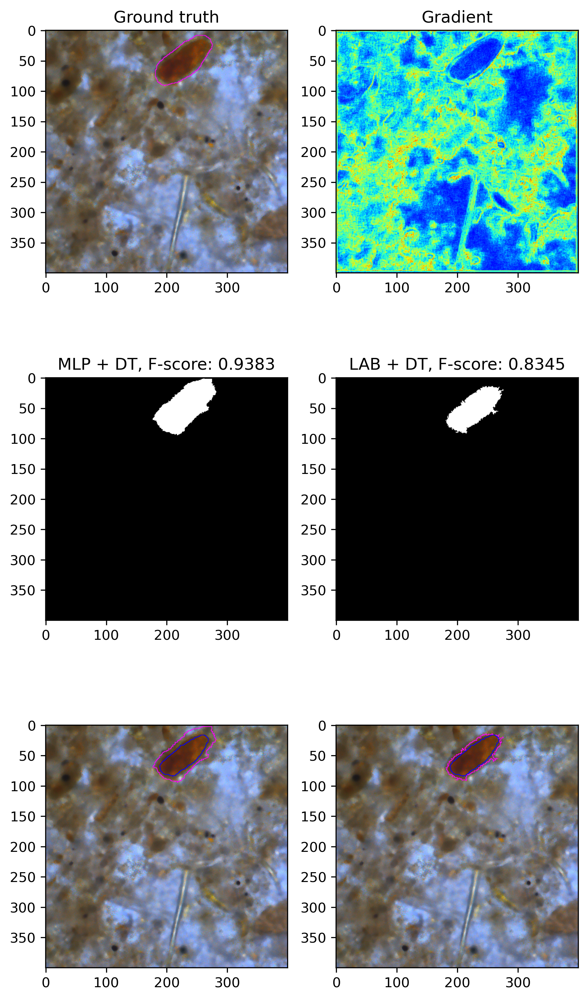

In [13]:
use_gt = False

sample = next(iter(test_dataset_gwe))
x,y = sample['image'].cuda(),sample['label']

while(sample['label'].max() == 0):
    sample = next(iter(test_dataset_gwe))
    x,y = sample['image'].cuda(),sample['label']

representation_ = graph_weight_estimator(x)

y[y>0] = 1
y = y[0].cpu().numpy()

if(not use_gt):
    plot_imgs = []
    x_t = labnorm(x)
    y_t = flim_model.forward(x_t, decoder_layer=1)
    y_t = y_t.squeeze().detach().cpu().numpy().astype(np.int32)
    
    plot_imgs.append(y_t)
    y_t_p = y_t.copy()
    th = threshold_otsu(y_t_p)
    y_t_p[y_t_p<th] = 0
    y_t_p[y_t_p>0] = 1
    plot_imgs.append(y_t_p)
    y_t_p = filter_component_by_area(y_t_p.astype(np.uint8), area_range=[1000,9000])
    plot_imgs.append(y_t_p)
    plot_images(plot_imgs,titles=["FLIM", "Otsu", "Component Filter"], cols=2 ,save_fig=f"{home}/report/outputs.png")
else:
    eroded = binary_erosion(y, footprint=disk(5)).astype(np.int32)
    dilated = binary_dilation(y, footprint=disk(10)).astype(np.int32)
    y_t_p = eroded

output_image = np.zeros((400, 400))
representation_np = representation_.detach().cpu().numpy()

plot_images(np.transpose(representation_np, (2,0,1)),save_fig=f"{home}/report/mlp_output.png")

h,w = output_image.shape
r = 1

dx = representation_np[1:,:,:] - representation_np[:-1,:,:]
dy = representation_np[:,1:,:] - representation_np[:,:-1,:]
grad_x = np.linalg.norm(dx, axis=2)
grad_y = np.linalg.norm(dy, axis=2)
grad = np.zeros((h,w))
grad[:-1,:] += grad_x
grad[:,:-1] += grad_y
output_image = np.sqrt(grad)


if(use_gt):        
    saliency = ift.CreateImageFromNumPy((y*255).astype(np.int32), is3D=False)
else:
    saliency = ift.CreateImageFromNumPy((y_t).astype(np.int32), is3D=False)

seeds_in = random_select(eroded, percentage=0.2).astype(np.int32)
seeds_out = random_select(1-dilated, percentage=0.2).astype(np.int32)
seeds_in_mimg = ift.CreateImageFromNumPy(seeds_in, is3D=False)
seeds_out_mimg = ift.CreateImageFromNumPy(seeds_out, is3D=False)


res_mimg = ift.CreateMImageFromNumPy(np.ascontiguousarray(representation_np.astype(np.float32)))
orig_mimg = ift.CreateMImageFromNumPy(np.ascontiguousarray(x.squeeze().permute((1,2,0)).detach().cpu().numpy().astype(np.float32)))


# res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 2, 30, 1)        
res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 2, 30)        

# res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 2, 30, 1)
res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 2, 30)

res_mlp = res.AsNumPy()
res_lab = res1.AsNumPy()

img = Image.open(sample['image_path'][0])
img_gt = draw_borders(img, y, edge_width=1)
img_mlp = draw_borders(img, res_mlp,edge_width=1)
img_mlp = draw_borders(img_mlp, y_t_p, edge_width=1, color='blue')
img_lab = draw_borders(img, res_lab,edge_width=1)
img_lab = draw_borders(img_lab, y_t_p, edge_width=1, color='blue')


fig,ax = plt.subplots(3,2,figsize=(7,13), dpi=300)
ax = ax.flatten()
ax[0].imshow(img_gt)
ax[0].set_title('Ground truth')
ax[1].imshow(output_image, cmap='jet')
ax[1].set_title(f'Gradient')
ax[2].imshow(res_mlp, cmap='gray')
ax[2].set_title(f"MLP + DT, F-score: {f_beta_score(y,res_mlp):.4f}")
ax[3].imshow(res_lab, cmap='gray')
ax[3].set_title(f"LAB + DT, F-score: {f_beta_score(y,res_lab):.4f}")
ax[4].imshow(img_mlp)
ax[5].imshow(img_lab)

# Trying new FLIMs

## Utils

In [14]:
from sklearn.metrics import f1_score, recall_score, confusion_matrix

def infRec(img, marker):
    '''
    img: binary np array
    marker: binary np array
    '''

    ift_img = ift.CreateImageFromNumPy(np.ascontiguousarray((img).astype(np.int32)),is3D=False)
    ift_marker = ift.CreateImageFromNumPy(np.ascontiguousarray((marker).astype(np.int32)),is3D=False)

    return ift.InferiorRec(ift_img, ift_marker,mask=None).AsNumPy()

def sensitivity_specificity(pred, gt):
    y_pred = pred.ravel()
    y_true = gt.ravel()

    # Sensitivity = recall
    sensitivity = recall_score(y_true, y_pred)

    # Specificity = TN / (TN+FP)
    tn, fp, fn, tp = confusion_matrix(y_true, y_pred).ravel()
    specificity = tn / (tn + fp)

    return sensitivity, specificity

def test_step(sample, model):

    x,y,p=sample['image'].cuda(),sample['label'], sample['image_path']
    y[y>0] = 1
    
    y = y[0].cpu().numpy()

    y[y>0] = 1
    # y = y[0].cpu().numpy()


    x_t = labnorm(x)
    # y_t = model.forward(x_t, decoder_layer=1)
    y_t = model.forward(x_t)
    y_t = y_t.squeeze().detach().cpu().numpy().astype(np.int32)
    
    y_t_p = y_t.copy()
    th = threshold_otsu(y_t_p)
    y_t_p[y_t_p<th] = 0
    y_t_p[y_t_p>0] = 1
    y_t_p = filter_component_by_area(y_t_p.astype(np.uint8), area_range=[1000,9000])

    dice = (f1_score(y.astype(np.int8).ravel(), y_t_p.ravel()))
    sens, spec = sensitivity_specificity(y_t_p, y.astype(np.int8))
    fbeta = f_beta_score(y,y_t_p)
    return dice, sens, spec, fbeta

def test_flim(dataset, model):
    dices = []
    specs = []
    senss = []
    fbetas = []
    for i, sample in enumerate(dataset):
        print(f"Sample {i}/{len(dataset)}", end='\r')
        dice, sens, spec, fbeta = test_step(sample, model)
        dices.append(dice), specs.append(spec), senss.append(sens), fbetas.append(fbeta)
    print(f"Dice: {np.average(dices):.4f}+-{np.std(dices):.4f}")
    print(f"Specificity: {np.average(specs):.4f}+-{np.std(specs):.4f}")
    print(f"Sensitivity: {np.average(senss):.4f}+-{np.std(senss):.4f}")
    print(f"F-beta: {np.average(fbetas):.4f}+-{np.std(fbetas):.4f}")
    return

def display_flim_dataset(markers_path, cols, save_fig=None):
    images_path = f"{home}/datasets/schisto/images/"
    markers_files = os.listdir(markers_path)

    seeds_imgs = []
    imgs_names = []

    for i, file in enumerate(markers_files):

        img_name = file.replace("-seeds.txt", ".png")  # FIXED
        img_path = os.path.join(images_path, img_name)
        marker_path = os.path.join(markers_path, file)

        img = cv2.imread(img_path, cv2.IMREAD_COLOR)
        img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)  # FIXED

        seeds_img = img.copy()

        with open(marker_path, "r") as txt_file:
            next(txt_file)  # skip header
            for line in txt_file:
                seed = [int(j) for j in line.strip().split()]  # FIXED
                # seed = [int(j) for j in line.strip().split(" ")]
                x, y, _, cls, __ = seed

                if cls == 0:
                    seeds_img[y, x] = [255, 255, 255]
                elif cls == 1:
                    seeds_img[y, x] = [255, 255, 0]
        seeds_imgs.append(seeds_img)
        imgs_names.append(img_name)

    plot_images(seeds_imgs, titles=imgs_names, cols=cols, save_fig=save_fig)
    return

def display_flim_outputs(t, old_dice, old_filtered_dice, new_dice, filtered_dice, old_spec, old_sens, new_spec, new_sens, titles):

    name = t["name"][-10:]
    orig = np.array(Image.open(t["name"]))

    fig, axes = plt.subplots(1, len(titles), figsize=(12, 4))
    
    remaining_keys = list(t.keys())[1:]  # skip 'name'
    images = [orig] + [t[k] for k in remaining_keys]  # append in order

    for ax, img, title in zip(axes, images, titles):
        ax.imshow(img, cmap="gray" if img.ndim == 2 else None)
        ax.set_title(title)
        ax.axis("off")

    plt.suptitle(f"{name}: D - {old_filtered_dice[-1]:.4f} to {filtered_dice[-1]:.4f}; SE: {old_sens[-1]:.4f} to {new_sens[-1]:.4f}; SP: {old_spec[-1]:.4f} to {new_spec[-1]:.4f}", fontsize=14)

    plt.tight_layout()
    plt.show()

    return

def mix_flims(dataset, flim1, flim2, use_decoder=False, use_filter=False, display=True, thresh=None, otsu=True, th=220):

    new_dices = []
    old_dices = []
    old_filtered_dices = []
    filtered_dices = []
    old_spec = []
    old_sens = []
    new_spec = []
    new_sens = []
    f_betas = []


    worst = []

    for i, sample in enumerate(dataset):

        x,y,p=sample['image'].cuda(),sample['label'], sample['image_path']

        print(f"Sample {i}/{len(dataset)}: {p[0][-10:]}", end='\r')

        y[y>0] = 1
        
        y_np = y[0].cpu().numpy()
        x_t = labnorm(x)

        ### FLIM 1
        if use_decoder:
            y_t = flim1.forward(x_t, decoder_layer=1)
        else:
            y_t = flim1.forward(x_t)
        y_t = y_t.squeeze().detach().cpu().numpy().astype(np.int32)
        
        y_t_p = y_t.copy()
        if otsu == True:
            th = threshold_otsu(y_t_p)
        y_t_p[y_t_p<th] = 0
        y_t_p[y_t_p>0] = 1
        
        y_t_p_filtered_area1 = filter_component_by_area(y_t_p.astype(np.uint8), area_range=[1000,9000]).astype(np.int32)

        y_t_p1 = y_t_p.copy()

        ### FLIM 2

        if use_decoder:
            y_t = flim2.forward(x_t, decoder_layer=1)
        else:
            y_t = flim2.forward(x_t)
        y_t = y_t.squeeze().detach().cpu().numpy().astype(np.int32)
        
        y_t_p = y_t.copy()
        y_t_before = y_t.copy()

        th = threshold_otsu(y_t_p)
        y_t_p[y_t_p<th] = 0
        y_t_p[y_t_p>0] = 1

        y_t_p2 = y_t_p.copy()

        y_t_p_filtered_area2 = filter_component_by_area(y_t_p.astype(np.uint8), area_range=[1000,9000]).astype(np.int32)

        if use_filter:
            y_t_p_and = cv2.bitwise_and(y_t_p_filtered_area1, y_t_p2)
            y_t_p = infRec(y_t_p_filtered_area1, y_t_p_and)
        else:
            y_t_p_and = cv2.bitwise_and(y_t_p1, y_t_p2)
            y_t_p = infRec(y_t_p1, y_t_p_and)

        y_t_p_filtered_area = filter_component_by_area(y_t_p.astype(np.uint8), area_range=[1000,9000])

        triplet = {}
        # print("IMAGE_PATH: ", sample["image_path"])
        triplet["name"] = sample['image_path'][0]
        triplet["gt"] = y_np
        triplet['flim1'] = y_t_p1
        if use_filter:
            triplet['flim1'] = y_t_p_filtered_area1
        else:
            triplet['flim1'] = y_t_p1
        triplet['flim1_filtered'] = y_t_p_filtered_area1
        triplet['flim2_before'] = y_t_before
        triplet['flim2'] = y_t_p2
        triplet['and'] = y_t_p_and
        triplet['inf_rec'] = y_t_p
        triplet['filtered'] = y_t_p_filtered_area

        # print(np.max(y_np), np.max(y_t_p_filtered_area))
        old_dices.append(f1_score(y_np.astype(np.int8).ravel(), y_t_p1.ravel()))
        old_filtered_dice = f1_score(y_np.astype(np.int8).ravel(), y_t_p_filtered_area1.ravel())
        old_filtered_dices.append(old_filtered_dice)
        sens, spec = sensitivity_specificity(y_t_p_filtered_area1, y_np.astype(np.int8))
        fbeta = f_beta_score(y_np.astype(np.int8), y_t_p_filtered_area)

        old_sens.append(sens)
        old_spec.append(spec)

        new_dices.append(f1_score(y_t_p.ravel(),y_np.ravel()))
        filtered_dice = f1_score(y_t_p_filtered_area.ravel(),y_np.ravel())
        filtered_dices.append(filtered_dice)
        sens, spec = sensitivity_specificity(y_t_p_filtered_area, y_np.astype(np.int8))
        new_sens.append(sens)
        new_spec.append(spec)
        f_betas.append(fbeta)
        
        
        if thresh!=None and old_filtered_dice<thresh:
            worst.append(sample['image_path'][0][-10:])

        if display:
            if thresh == None:
                display_flim_outputs(triplet, old_dices, old_filtered_dices, new_dices, filtered_dices, old_spec, old_sens, new_spec, new_sens, ["Original", "GT", "FLIM1 Otsu", "FLIM1 Filtered", "FLIM2", "FLIM2 Otsu", "FLIMs 1 and 2", "Inf Rec", "Filtered"])
            elif filtered_dice<thresh:
                display_flim_outputs(triplet, old_dices, old_filtered_dices, new_dices, filtered_dices, old_spec, old_sens, new_spec, new_sens, ["Original", "GT", "FLIM1 Otsu", "FLIM1 Filtered", "FLIM2", "FLIM2 Otsu", "FLIMs 1 and 2", "Inf Rec", "Filtered"])


    print(f"F-Beta: {np.average(f_betas):.4f}+-{np.std(f_betas):.4f}")
    print(f"Sensitivity: {np.average(new_sens):.4f}+-{np.std(new_sens):.4f}")
    print(f"Specificity: {np.average(new_spec):.4f}+-{np.std(new_spec):.4f}") 
    print(f"Dice: {np.average(filtered_dices):.4f}+-{np.std(filtered_dices):.4f}")   
    print(f"Worst: {worst}")

    return

## FLIM Baseline (4 layers / split3)

Let's evaluate the baseline FLIM in the validation set

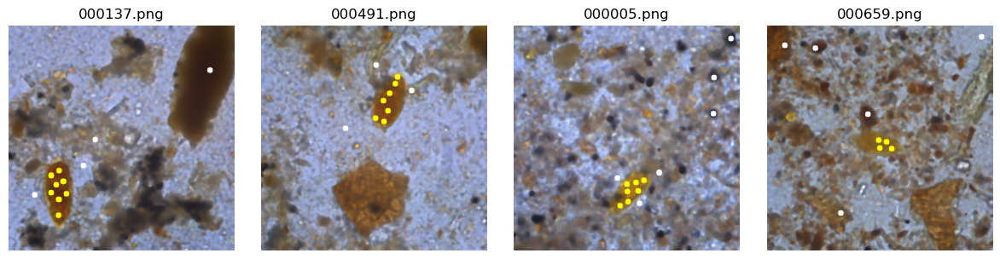

Dice: 0.6887+-0.1782
Specificity: 0.9930+-0.0146
Sensitivity: 0.6292+-0.1505
F-beta: 0.6473+-0.1515


In [15]:
split =3
markers_path = f"{home}/data/schisto/split{split}/markers/"
flim_model1 = torch.load(f'{home}/models/flim/split{split}/flim_encoder_split{split}.pth', weights_only=False).eval().to(device)
display_flim_dataset(markers_path, cols=4)
test_flim(val_dataset_gwe, flim_model1)

## New FLIM (4 layers / split4)

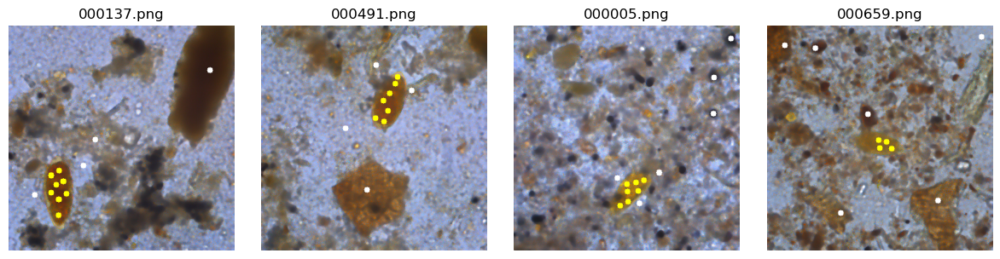

Dice: 0.6851+-0.1675
Specificity: 0.9958+-0.0109
Sensitivity: 0.5910+-0.1497
F-beta: 0.6261+-0.1510


In [16]:
split = 4
markers_path = f"{home}/data/schisto/mysplit{split}_4/markers/"
flim_model2 = torch.load(f'{home}/models/flim/mysplit{split}_4/flim_encoder_mysplit{split}_4.pth', weights_only=False).eval().to(device)
display_flim_dataset(markers_path, save_fig=f'{home}/report/markers_split4.png',cols=4)
test_flim(val_dataset_gwe, flim_model2)

## New FLIM (4 layers / split5)

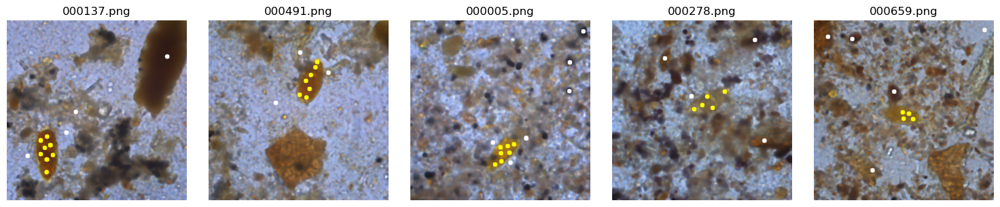

Dice: 0.5735+-0.2543
Specificity: 0.9646+-0.0359
Sensitivity: 0.7824+-0.2365
F-beta: 0.6506+-0.2337


In [25]:
split = 5
layers = 4
markers_path = f"{home}/data/schisto/mysplit{split}_{layers}/markers/"
flim_model3 = torch.load(f'{home}/models/flim/mysplit{split}_{layers}/flim_encoder_mysplit{split}_{layers}.pth', weights_only=False).eval().to(device)
display_flim_dataset(markers_path, save_fig=f"{home}/report/flim_markers_split5.png",cols=5)
test_flim(val_dataset_gwe, flim_model3)

# Two FLIMs - Baseline + Deeper

## FLIM pipeline only

First, let's see try the baseline FLIM with other deeper FLIMs (6, 7, 8 and 12 layers) in the validation set

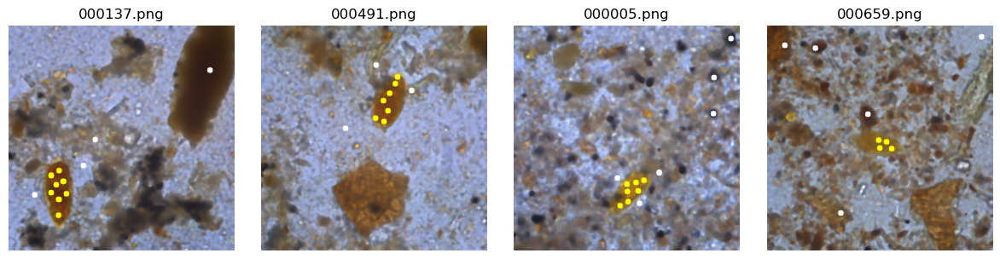

########################### FLIM 4 + 6 layers
F-Beta: 0.6478+-0.1512.png
Sensitivity: 0.6292+-0.1505
Specificity: 0.9931+-0.0145
Dice: 0.6895+-0.1773
Worst: []
########################### FLIM 4 + 7 layers
F-Beta: 0.6470+-0.1573.png
Sensitivity: 0.6270+-0.1570
Specificity: 0.9934+-0.0143
Dice: 0.6901+-0.1818
Worst: []
########################### FLIM 4 + 8 layers
F-Beta: 0.6326+-0.1910.png
Sensitivity: 0.6120+-0.1886
Specificity: 0.9935+-0.0143
Dice: 0.6759+-0.2152
Worst: []
########################### FLIM 4 + 12 layers
F-Beta: 0.3286+-0.3503.png
Sensitivity: 0.3134+-0.3356
Specificity: 0.9964+-0.0100
Dice: 0.3543+-0.3793
Worst: []


In [18]:
split =3
markers_path = f"{home}/data/schisto/split{split}/markers/"
display_flim_dataset(markers_path, cols=4)

flim_model1 = torch.load(f'{home}/models/flim/split{split}/flim_encoder_split{split}.pth', weights_only=False).eval().to(device)
flim_model4 = torch.load(f'{home}/models/flim/mysplit{split}_6/flim_encoder_mysplit{split}_6.pth', weights_only=False).eval().to(device)
print("########################### FLIM 4 + 6 layers")
mix_flims(val_dataset_gwe, flim_model1, flim_model4, th=0.3, display=False)

flim_model5 = torch.load(f'{home}/models/flim/mysplit{split}_7/flim_encoder_mysplit{split}_7.pth', weights_only=False).eval().to(device)
print("########################### FLIM 4 + 7 layers")
mix_flims(val_dataset_gwe, flim_model1, flim_model5, th=0.3, display=False, otsu=True, use_filter=True)

flim_model6 = torch.load(f'{home}/models/flim/mysplit{split}/flim_encoder_mysplit{split}.pth', weights_only=False).eval().to(device)
print("########################### FLIM 4 + 8 layers")
mix_flims(val_dataset_gwe, flim_model1, flim_model6, th=0.3, display=False, otsu=True, use_filter=True)

flim_model7 = torch.load(f'{home}/models/flim/mysplit{split}_12/flim_encoder_mysplit{split}_12.pth', weights_only=False).eval().to(device)
print("########################### FLIM 4 + 12 layers")
mix_flims(val_dataset_gwe, flim_model1, flim_model7, th=0.3, display=False, otsu=True, use_filter=True)

## Validation - Full Pipeline

In [19]:
del graph_weight_estimator
graph_weight_estimator = torch.load(f'{home}/models/estimator_network/best_model_w_flim_triplet_split{split}.pth', weights_only=False)
# graph_weight_estimator = torch.load(f'{home}/models/estimator_network/best_model_w_flim_triplet_split{split}.pth', weights_only=False)
split = 3
flim_model1 = torch.load(f'{home}/models/flim/split{split}/flim_encoder_split{split}.pth', weights_only=False).eval().to(device)
flim_model2 = torch.load(f'{home}/models/flim/mysplit{split}_7/flim_encoder_mysplit{split}_7.pth', weights_only=False).eval().to(device)


test_loss_lab = []
test_loss_mlp = []
graph_weight_estimator.eval()
flim_model.eval()
start_time = time.perf_counter()
use_gt = False


fbeta_mlp_scores = []
fbeta_lab_scores = []

sensitivity_mlp_scores = []
sensitivity_lab_scores = []

specificity_mlp_scores = []
specificity_lab_scores = []

dice_mlp_scores = []
dice_lab_scores = []

worst_imgs = []
worst_titles_2flims_val = []
worst_saliencies = []
worst_gts = []

with torch.no_grad():    
    for sample in tqdm(val_dataset_gwe):
        x,y=sample['image'].cuda(),sample['label']
        y[y>0] = 1
        y = y[0].cpu().numpy()
        
        representation = graph_weight_estimator(x)

        if(not use_gt):   
            x_t = labnorm(x)

            ##### FLIM 1
            y_t = flim_model1.forward(x_t, decoder_layer=0)
            y_t = y_t.squeeze().detach().cpu().numpy().astype(np.int32)
            y_t_p = y_t.copy()
            th = threshold_otsu(y_t_p)
            y_t_p[y_t_p<th] = 0
            y_t_p[y_t_p>0] = 1
            y_t_p1 = y_t_p.copy()

            ##### FLIM 2
            y_t = flim_model2.forward(x_t)
            y_t = y_t.squeeze().detach().cpu().numpy().astype(np.int32)
            y_t_p = y_t.copy()
            th = threshold_otsu(y_t_p)
            y_t_p[y_t_p<th] = 0
            y_t_p[y_t_p>0] = 1

            y_t_p2 = y_t_p.copy()

            ##### AND / infRec
            y_t_p_and = cv2.bitwise_and(y_t_p1, y_t_p2)
            y_t_p = infRec(y_t_p1, y_t_p_and)

            saliency = ift.CreateImageFromNumPy((y_t_p*255).astype(np.int32), is3D=False)
        else:
            saliency = ift.CreateImageFromNumPy((y*255).astype(np.int32), is3D=False)

        res_mimg = ift.CreateMImageFromNumPy(np.ascontiguousarray(representation.detach().cpu().numpy().astype(np.float32)))
        orig_mimg = ift.CreateMImageFromNumPy(np.ascontiguousarray(x.squeeze().permute((1,2,0)).detach().cpu().numpy().astype(np.float32)))

        # Here we use a method that do pre-processings on the masks before dynamic trees, for details look at iftSegmentation.c
        # Parameters: (mimg, saliency, border, min comp area, max comp area, saliency erosion, saliency dilation)
        if(not use_gt):
            res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 2, 30)       
            res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 2, 30)
            # res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 10, 40)       
            # res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 10, 40)
        else:
            res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 5, 10)       
            res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 5, 10)
            # res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 10, 40)       
            # res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 10, 40)
        
        res = res.AsNumPy()
        res1 = res1.AsNumPy()
        
        # loss_mlp = f_beta_score(y, res)
        # loss_lab = f_beta_score(y, res1)
        
        # test_loss_mlp.append(loss_mlp) 
        # test_loss_lab.append(loss_lab)

        f_beta_mlp = f_beta_score(y, res)
        f_beta_lab = f_beta_score(y, res1)
        fbeta_mlp_scores.append(f_beta_mlp)
        fbeta_lab_scores.append(f_beta_lab)
        
        y = (y > 0.5).astype(np.uint8)
        sens_mlp = sensitivity(res, y)
        sens_lab = sensitivity(res1, y)
        sensitivity_mlp_scores.append(sens_mlp)
        sensitivity_lab_scores.append(sens_lab)
        
        specificity_mlp = specificity(res, y)
        specificity_lab = specificity(res1, y)
        specificity_mlp_scores.append(specificity_mlp)
        specificity_lab_scores.append(specificity_lab)
        
        dice_mlp = dice_score(res, y)
        dice_lab = dice_score(res1, y)
        dice_mlp_scores.append(dice_mlp)
        dice_lab_scores.append(dice_lab)

        if f_beta_mlp<0.2:
            worst_titles_2flims_val.append(os.path.basename(sample['image_path'][0]))
            # worst_imgs.append(sample['image'][0].permute(1, 2, 0).cpu().numpy()[..., ::-1])
            worst_imgs.append(np.array(Image.open(sample['image_path'][0])))
            worst_gts.append(y)
            if not use_gt:
                worst_saliencies.append(y_t)

print('time:', time.perf_counter()-start_time)

# print('Metric lab: ', np.mean(test_loss_lab),'+-',np.std(test_loss_lab), '| Metric lab Std: ', np.std(test_loss_lab), end="\n")
# print('Metric mlp: ', np.mean(test_loss_mlp),'+-',np.std(test_loss_mlp), '| Metric mlp Std: ', np.std(test_loss_mlp), end="\n")

print(f"F-beta MLP: {np.mean(fbeta_mlp_scores):.4f} ± {np.std(fbeta_mlp_scores):.4f} | "
      f"F-beta Lab: {np.mean(fbeta_lab_scores):.4f} ± {np.std(fbeta_lab_scores):.4f}")

print(f"Sensitivity MLP: {np.mean(sensitivity_mlp_scores):.4f} ± {np.std(sensitivity_mlp_scores):.4f} | "
      f"Sensitivity Lab: {np.mean(sensitivity_lab_scores):.4f} ± {np.std(sensitivity_lab_scores):.4f}")

print(f"Specificity MLP: {np.mean(specificity_mlp_scores):.4f} ± {np.std(specificity_mlp_scores):.4f} | "
      f"Specificity Lab: {np.mean(specificity_lab_scores):.4f} ± {np.std(specificity_lab_scores):.4f}")

print(f"Dice MLP: {np.mean(dice_mlp_scores):.4f} ± {np.std(dice_mlp_scores):.4f} | "
      f"Dice Lab: {np.mean(dice_lab_scores):.4f} ± {np.std(dice_lab_scores):.4f}")

  0%|          | 0/163 [00:00<?, ?it/s]

time: 37.72465542600003
F-beta MLP: 0.8398 ± 0.2416 | F-beta Lab: 0.8148 ± 0.2250
Sensitivity MLP: 0.9039 ± 0.2508 | Sensitivity Lab: 0.8194 ± 0.2238
Specificity MLP: 0.9895 ± 0.0142 | Specificity Lab: 0.9951 ± 0.0119
Dice MLP: 0.7856 ± 0.2415 | Dice Lab: 0.8200 ± 0.2386


In [20]:
# plot_images(worst_imgs, titles=worst_titles, save_fig="report/worst_imgs_2flims.png")
# plot_images(worst_saliencies, titles=worst_titles, save_fig="report/worst_saliencies_2flims.png")
# plot_images(worst_gts, titles=worst_titles, save_fig="report/worst_gts_2flims.png")
worst_titles_2flims_val = worst_titles
print(worst_titles_2flims_val)

['000829.png', '000373.png', '000294.png', '000523.png', '000895.png', '001188.png', '000166.png', '000949.png', '000086.png', '001210.png', '001209.png']


Did we solve some of the previous worst cases? How many of the current worst cases are the same worst cases seen before?

In [21]:
cases_in_common = set(worst_titles_val) & set(worst_titles_2flims_val)
count_cases_in_common= len(cases_in_common)

print(cases_in_common)   
print(count_cases_in_common) 

{'000895.png', '000294.png', '001188.png', '001210.png', '000949.png', '000086.png', '000166.png', '001209.png', '000373.png', '000829.png', '000523.png'}
11


## Test - Full Pipeline

In [22]:
del graph_weight_estimator
graph_weight_estimator = torch.load(f'{home}/models/estimator_network/best_model_w_flim_triplet_split{split}.pth', weights_only=False)
# graph_weight_estimator = torch.load(f'{home}/models/estimator_network/best_model_w_flim_triplet_split{split}.pth', weights_only=False)
split = 3
flim_model1 = torch.load(f'{home}/models/flim/split{split}/flim_encoder_split{split}.pth', weights_only=False).eval().to(device)
flim_model2 = torch.load(f'{home}/models/flim/mysplit{split}_7/flim_encoder_mysplit{split}_7.pth', weights_only=False).eval().to(device)


test_loss_lab = []
test_loss_mlp = []
graph_weight_estimator.eval()
flim_model.eval()
start_time = time.perf_counter()
use_gt = False


fbeta_mlp_scores = []
fbeta_lab_scores = []

sensitivity_mlp_scores = []
sensitivity_lab_scores = []

specificity_mlp_scores = []
specificity_lab_scores = []

dice_mlp_scores = []
dice_lab_scores = []

worst_imgs = []
worst_titles = []
worst_saliencies = []
worst_gts = []

with torch.no_grad():    
    for sample in tqdm(test_dataset_gwe):
        x,y=sample['image'].cuda(),sample['label']
        y[y>0] = 1
        y = y[0].cpu().numpy()
        
        representation = graph_weight_estimator(x)

        if(not use_gt):   
            x_t = labnorm(x)

            ##### FLIM 1
            y_t = flim_model1.forward(x_t, decoder_layer=0)
            y_t = y_t.squeeze().detach().cpu().numpy().astype(np.int32)
            y_t_p = y_t.copy()
            th = threshold_otsu(y_t_p)
            y_t_p[y_t_p<th] = 0
            y_t_p[y_t_p>0] = 1
            y_t_p1 = y_t_p.copy()

            ##### FLIM 2
            y_t = flim_model2.forward(x_t)
            y_t = y_t.squeeze().detach().cpu().numpy().astype(np.int32)
            y_t_p = y_t.copy()
            th = threshold_otsu(y_t_p)
            y_t_p[y_t_p<th] = 0
            y_t_p[y_t_p>0] = 1

            y_t_p2 = y_t_p.copy()

            ##### AND / infRec
            y_t_p_and = cv2.bitwise_and(y_t_p1, y_t_p2)
            y_t_p = infRec(y_t_p1, y_t_p_and)

            saliency = ift.CreateImageFromNumPy((y_t_p*255).astype(np.int32), is3D=False)
        else:
            saliency = ift.CreateImageFromNumPy((y*255).astype(np.int32), is3D=False)

        res_mimg = ift.CreateMImageFromNumPy(np.ascontiguousarray(representation.detach().cpu().numpy().astype(np.float32)))
        orig_mimg = ift.CreateMImageFromNumPy(np.ascontiguousarray(x.squeeze().permute((1,2,0)).detach().cpu().numpy().astype(np.float32)))

        # Here we use a method that do pre-processings on the masks before dynamic trees, for details look at iftSegmentation.c
        # Parameters: (mimg, saliency, border, min comp area, max comp area, saliency erosion, saliency dilation)
        if(not use_gt):
            res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 2, 30)       
            res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 2, 30)
            # res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 10, 40)       
            # res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 10, 40)
        else:
            res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 5, 10)       
            res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 5, 10)
            # res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 10, 40)       
            # res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 10, 40)
        
        res = res.AsNumPy()
        res1 = res1.AsNumPy()
        
        # loss_mlp = f_beta_score(y, res)
        # loss_lab = f_beta_score(y, res1)
        
        # test_loss_mlp.append(loss_mlp) 
        # test_loss_lab.append(loss_lab)

        f_beta_mlp = f_beta_score(y, res)
        f_beta_lab = f_beta_score(y, res1)
        fbeta_mlp_scores.append(f_beta_mlp)
        fbeta_lab_scores.append(f_beta_lab)
        
        y = (y > 0.5).astype(np.uint8)
        sens_mlp = sensitivity(res, y)
        sens_lab = sensitivity(res1, y)
        sensitivity_mlp_scores.append(sens_mlp)
        sensitivity_lab_scores.append(sens_lab)
        
        specificity_mlp = specificity(res, y)
        specificity_lab = specificity(res1, y)
        specificity_mlp_scores.append(specificity_mlp)
        specificity_lab_scores.append(specificity_lab)
        
        dice_mlp = dice_score(res, y)
        dice_lab = dice_score(res1, y)
        dice_mlp_scores.append(dice_mlp)
        dice_lab_scores.append(dice_lab)

        if f_beta_mlp<0.2:
            worst_titles.append(os.path.basename(sample['image_path'][0]))
            # worst_imgs.append(sample['image'][0].permute(1, 2, 0).cpu().numpy()[..., ::-1])
            worst_imgs.append(np.array(Image.open(sample['image_path'][0])))
            worst_gts.append(y)
            if not use_gt:
                worst_saliencies.append(y_t)

print('time:', time.perf_counter()-start_time)

# print('Metric lab: ', np.mean(test_loss_lab),'+-',np.std(test_loss_lab), '| Metric lab Std: ', np.std(test_loss_lab), end="\n")
# print('Metric mlp: ', np.mean(test_loss_mlp),'+-',np.std(test_loss_mlp), '| Metric mlp Std: ', np.std(test_loss_mlp), end="\n")

print(f"F-beta MLP: {np.mean(fbeta_mlp_scores):.4f} ± {np.std(fbeta_mlp_scores):.4f} | "
      f"F-beta Lab: {np.mean(fbeta_lab_scores):.4f} ± {np.std(fbeta_lab_scores):.4f}")

print(f"Sensitivity MLP: {np.mean(sensitivity_mlp_scores):.4f} ± {np.std(sensitivity_mlp_scores):.4f} | "
      f"Sensitivity Lab: {np.mean(sensitivity_lab_scores):.4f} ± {np.std(sensitivity_lab_scores):.4f}")

print(f"Specificity MLP: {np.mean(specificity_mlp_scores):.4f} ± {np.std(specificity_mlp_scores):.4f} | "
      f"Specificity Lab: {np.mean(specificity_lab_scores):.4f} ± {np.std(specificity_lab_scores):.4f}")

print(f"Dice MLP: {np.mean(dice_mlp_scores):.4f} ± {np.std(dice_mlp_scores):.4f} | "
      f"Dice Lab: {np.mean(dice_lab_scores):.4f} ± {np.std(dice_lab_scores):.4f}")

  0%|          | 0/610 [00:00<?, ?it/s]

time: 127.35518984999999
F-beta MLP: 0.8646 ± 0.2839 | F-beta Lab: 0.8546 ± 0.2782
Sensitivity MLP: 0.8946 ± 0.2891 | Sensitivity Lab: 0.8546 ± 0.2785
Specificity MLP: 0.9937 ± 0.0102 | Specificity Lab: 0.9966 ± 0.0091
Dice MLP: 0.8370 ± 0.2842 | Dice Lab: 0.8575 ± 0.2809


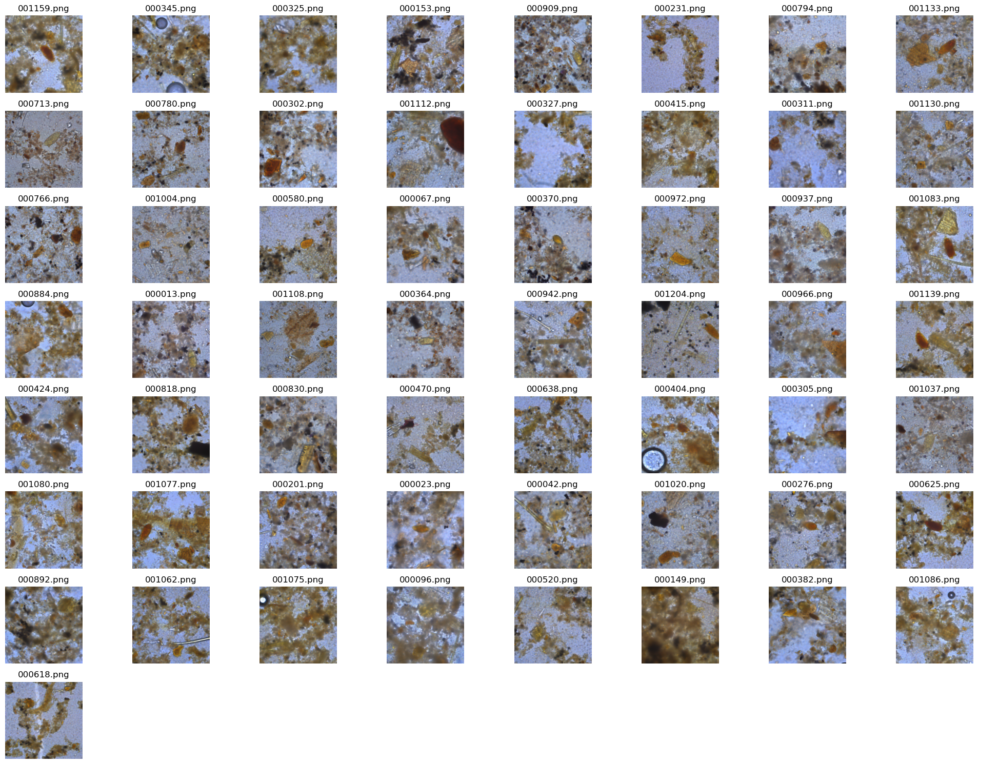

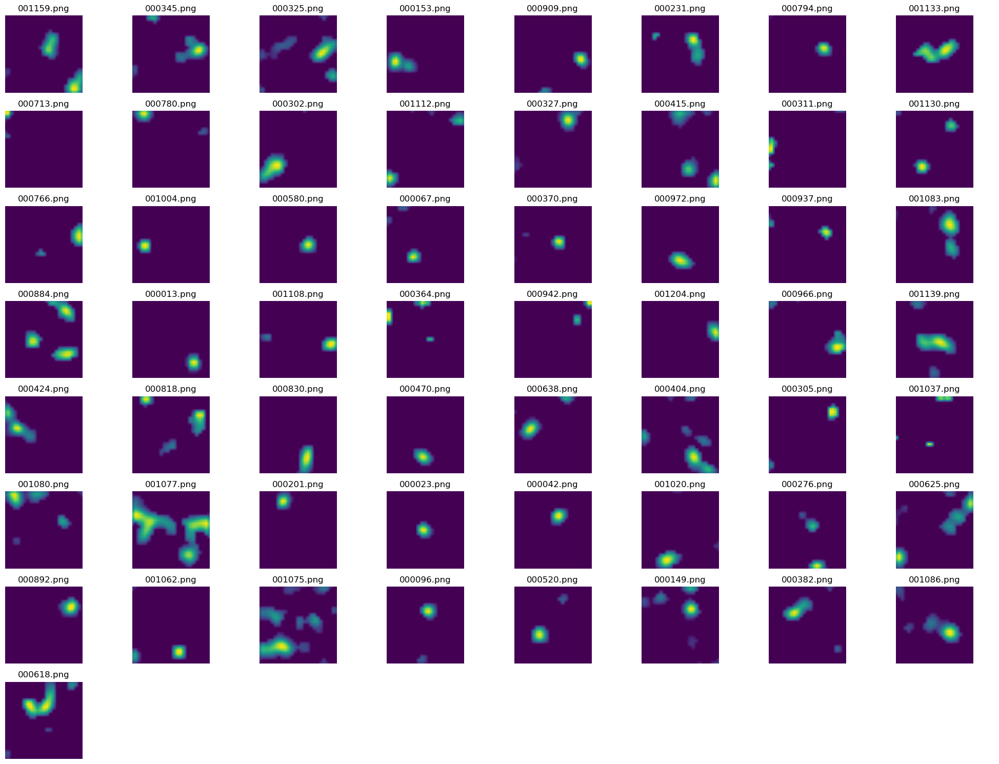

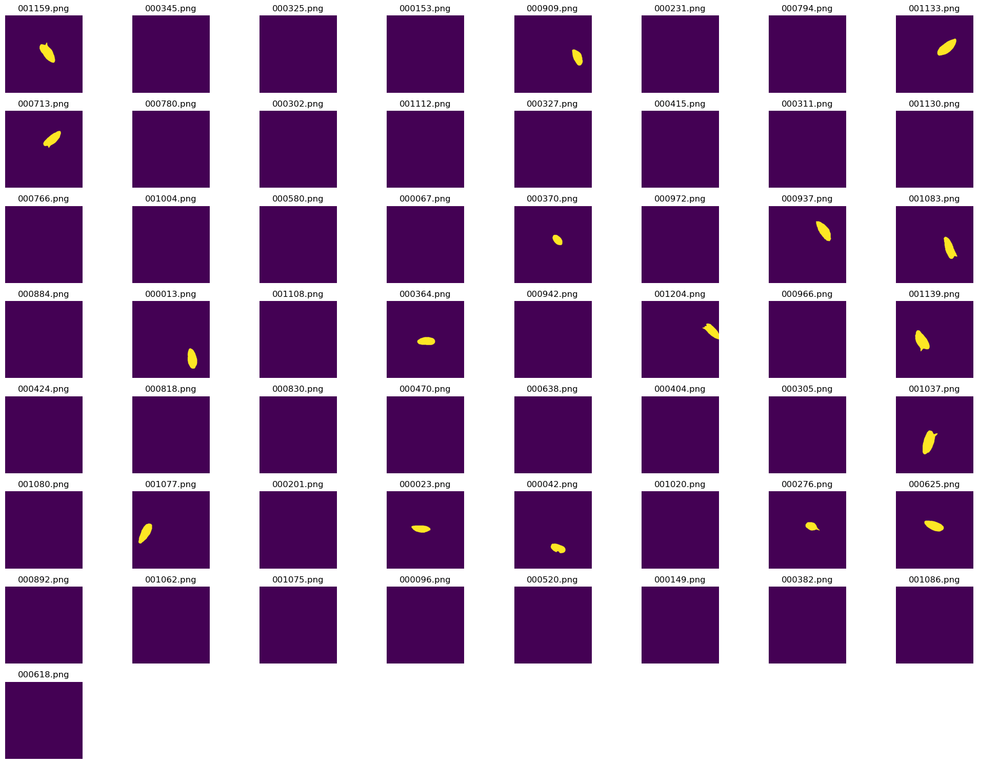

In [23]:
plot_images(worst_imgs, titles=worst_titles, save_fig="report/worst_imgs_2flims.png")
plot_images(worst_saliencies, titles=worst_titles, save_fig="report/worst_saliencies_2flims.png")
plot_images(worst_gts, titles=worst_titles, save_fig="report/worst_gts_2flims.png")
worst_titles_2flims = worst_titles

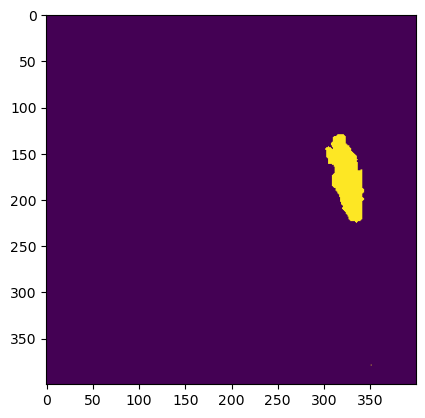

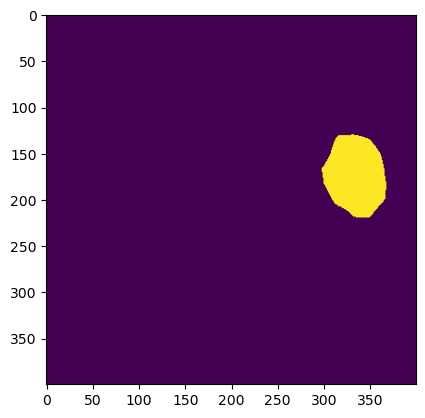

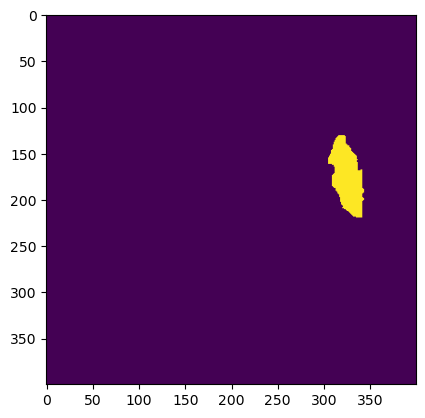

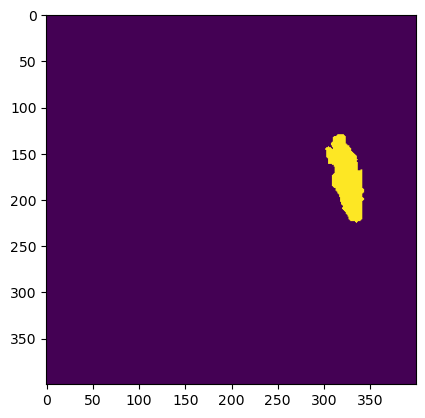

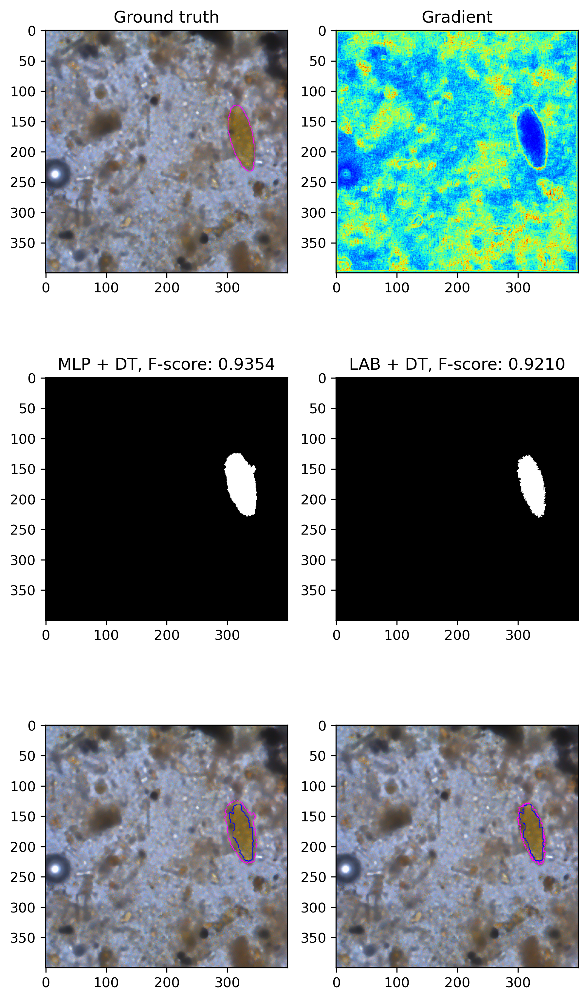

In [24]:
use_gt = False

sample = next(iter(test_dataset_gwe))
x,y = sample['image'].cuda(),sample['label']

while(sample['label'].max() == 0):
    sample = next(iter(test_dataset_gwe))
    x,y = sample['image'].cuda(),sample['label']

representation_ = graph_weight_estimator(x)

y[y>0] = 1
y = y[0].cpu().numpy()

if(not use_gt):
    x_t = labnorm(x)
    ##### FLIM 1
    y_t = flim_model1.forward(x_t, decoder_layer=0)
    y_t = y_t.squeeze().detach().cpu().numpy().astype(np.int32)
    y_t_p = y_t.copy()
    th = threshold_otsu(y_t_p)
    y_t_p[y_t_p<th] = 0
    y_t_p[y_t_p>0] = 1
    y_t_p1 = y_t_p.copy()
    plt.imshow(y_t_p1)
    plt.show()

    ##### FLIM 2
    y_t = flim_model2.forward(x_t)
    y_t = y_t.squeeze().detach().cpu().numpy().astype(np.int32)
    y_t_p = y_t.copy()
    th = threshold_otsu(y_t_p)
    y_t_p[y_t_p<th] = 0
    y_t_p[y_t_p>0] = 1

    y_t_p2 = y_t_p.copy()
    plt.imshow(y_t_p2)
    plt.show()

    ##### AND / infRec
    y_t_p_and = cv2.bitwise_and(y_t_p1, y_t_p2)
    plt.imshow(y_t_p_and)
    plt.show()
    y_t_p = infRec(y_t_p1, y_t_p_and)
    plt.imshow(y_t_p)
    plt.show()

    eroded = binary_erosion(y_t_p, footprint=disk(5)).astype(np.int32)
    dilated = binary_dilation(y_t_p, footprint=disk(10)).astype(np.int32)

else:
    eroded = binary_erosion(y, footprint=disk(5)).astype(np.int32)
    dilated = binary_dilation(y, footprint=disk(10)).astype(np.int32)
    y_t_p = eroded

output_image = np.zeros((400, 400))
representation_np = representation_.detach().cpu().numpy()

h,w = output_image.shape
r = 1

dx = representation_np[1:,:,:] - representation_np[:-1,:,:]
dy = representation_np[:,1:,:] - representation_np[:,:-1,:]
grad_x = np.linalg.norm(dx, axis=2)
grad_y = np.linalg.norm(dy, axis=2)
grad = np.zeros((h,w))
grad[:-1,:] += grad_x
grad[:,:-1] += grad_y
output_image = np.sqrt(grad)


if(use_gt):        
    saliency = ift.CreateImageFromNumPy((y*255).astype(np.int32), is3D=False)
else:
    saliency = ift.CreateImageFromNumPy((y_t_p*255).astype(np.int32), is3D=False)

seeds_in = random_select(eroded, percentage=0.2).astype(np.int32)
seeds_out = random_select(1-dilated, percentage=0.2).astype(np.int32)
seeds_in_mimg = ift.CreateImageFromNumPy(seeds_in, is3D=False)
seeds_out_mimg = ift.CreateImageFromNumPy(seeds_out, is3D=False)


res_mimg = ift.CreateMImageFromNumPy(np.ascontiguousarray(representation_np.astype(np.float32)))
orig_mimg = ift.CreateMImageFromNumPy(np.ascontiguousarray(x.squeeze().permute((1,2,0)).detach().cpu().numpy().astype(np.float32)))


# res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 2, 30, 1)        
res = ift.SMansoniDelineation(res_mimg, saliency, 1, 1000, 9000, 10, 40)        

# res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 2, 30, 1)
res1 = ift.SMansoniDelineation(orig_mimg, saliency, 1, 1000, 9000, 10, 40)

res_mlp = res.AsNumPy()
res_lab = res1.AsNumPy()

img = Image.open(sample['image_path'][0])
img_gt = draw_borders(img, y, edge_width=1)
img_mlp = draw_borders(img, res_mlp,edge_width=1)
img_mlp = draw_borders(img_mlp, y_t_p, edge_width=1, color='blue')
img_lab = draw_borders(img, res_lab,edge_width=1)
img_lab = draw_borders(img_lab, y_t_p, edge_width=1, color='blue')


fig,ax = plt.subplots(3,2,figsize=(7,13), dpi=300)
ax = ax.flatten()
ax[0].imshow(img_gt)
ax[0].set_title('Ground truth')
ax[1].imshow(output_image, cmap='jet')
ax[1].set_title(f'Gradient')
ax[2].imshow(res_mlp, cmap='gray')
ax[2].set_title(f"MLP + DT, F-score: {f_beta_score(y,res_mlp):.4f}")
ax[3].imshow(res_lab, cmap='gray')
ax[3].set_title(f"LAB + DT, F-score: {f_beta_score(y,res_lab):.4f}")
ax[4].imshow(img_mlp)
ax[5].imshow(img_lab)